# Dataset Creation

In [1]:
import pandas as pd
import numpy as np
import random
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

# graph settings : 
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [2]:
def randomNumber(x):
    return random.randint(0,x)
def randomDate(x):
    return random.randint(5,x)
def randomYear(x):
    return random.randint(1,x)
def randomColor():
    r = lambda: random.randint(0,255)
    return ('#%02X%02X%02X' % (r(),r(),r()))
def randomDateCust():
    return random.randint(1,2)


In [3]:
# for ground owners
#(date-pk,year(not required),day, month, week number , groundName, timeslot chosen , sport chosen ) --> cost spent

years = ['2010','2011','2012','2013','2014','2015','2016','2017','2018','2019','2020','2021']

days = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

groundNames = ['Ground1','Ground2','Ground3','Ground4']

timeslots = ['timeslot1','timeslot2','timeslot3','timeslot4','timeslot5','timeslot6','timeslot7']

months = ['January','February','March','April','May','June','July','August','September','October','November','December']

sports = ['sport1','sport2','sport3','sport4','sport5','sport6']

#for ground 1 : 
g1_prices = {'sport1':100,'sport2':150,'sport3':250,'sport4':350,'sport5':400,'sport6':200}
g2_prices = {'sport1':200,'sport2':150,'sport3':450,'sport4':250,'sport5':200,'sport6':100}
g3_prices = {'sport1':350,'sport2':450,'sport3':150,'sport4':200,'sport5':300,'sport6':250}
g4_prices = {'sport1':450,'sport2':250,'sport3':150,'sport4':100,'sport5':250,'sport6':500}


data = [] 
data2=[]
# assuming on an average,30 people and minimum 5 people visit the ground everyday 
for i in range(1,3000):  
    num_dates = randomDate(30)
    tot_cost=0
    tYear =""
    tDay=""
    tGroundName=""
    tTimeSlot=""
    tMonth =""
    tSport=""
    tDate = i
    tot_cust = num_dates
    day_cost = []
    
    for j in range(1,tot_cust):    
        tDay = days[randomNumber(len(days)-1)]
        tGroundName = groundNames[randomNumber(len(groundNames)-1)]
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        tMonth = months[randomNumber(len(months)-1)]
        if(tGroundName == 'Ground1'):
            tCost = g1_prices[tSport]
            day_cost.append(tCost)
            tot_cost+=tCost
        elif(tGroundName == 'Ground2'):
            tCost = g2_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground3'):
            tCost = g3_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground4'):
            tCost = g4_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        if(i<250):
            tYear = years[0]
        elif(i>=250 and i<500):
            tYear = years[1]
        elif(i>=500 and i<750):
            tYear = years[2]
        elif(i>=750 and i<1000):
            tYear = years[3]
        elif(i>=1000 and i<1250):
            tYear = years[4]
        elif(i>=1250 and i<1500):
            tYear = years[5]
        elif(i>=1500 and i<1750):
            tYear = years[6]
        elif(i>=1750 and i<2000):
            tYear = years[7]
        elif(i>=2000 and i<2250):
            tYear = years[8]
        elif(i>=2250 and i<2500):
            tYear = years[9]
        elif(i>=2500 and i<2750):
            tYear = years[10]
        elif(i>=2750 and i<3000):
            tYear = years[11]
        
            
        
            
    
    data.append([tDate,tYear,tDay,tMonth,tGroundName,tot_cost,tot_cust])
    for i in range(1,tot_cust):
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        data2.append([tDate,tYear,tDay,tMonth,tTimeSlot,tSport,tGroundName,day_cost[i-1]])

groundOwners_df = pd.DataFrame(data, columns = ['Date','Year', 'Day','Month','GroundName','Cost','TotalCustomers'])

groundOwners_df_percust = pd.DataFrame(data2,columns = ['Date','Year', 'Day','Month','TimeSlot','Sport','GroundName','Cost'])

In [4]:
groundOwners_df

,Date,Year,Day,Month,GroundName,Cost,TotalCustomers
0,1,2010,Wednesday,August,Ground3,7300,28
1,2,2010,Sunday,February,Ground2,2200,9
2,3,2010,Friday,January,Ground1,2550,10
3,4,2010,Friday,April,Ground1,4550,18
4,5,2010,Monday,November,Ground2,4200,13
...,...,...,...,...,...,...,...
2994,2995,2021,Tuesday,January,Ground4,2700,13
2995,2996,2021,Tuesday,April,Ground2,2650,13
2996,2997,2021,Tuesday,February,Ground3,4050,18
2997,2998,2021,Monday,June,Ground2,3500,15


In [5]:
groundOwners_df_percust

,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost
0,1,2010,Wednesday,August,timeslot3,sport4,Ground3,250
1,1,2010,Wednesday,August,timeslot4,sport5,Ground3,200
2,1,2010,Wednesday,August,timeslot1,sport5,Ground3,350
3,1,2010,Wednesday,August,timeslot4,sport1,Ground3,200
4,1,2010,Wednesday,August,timeslot5,sport1,Ground3,150
...,...,...,...,...,...,...,...,...
49069,2999,2021,Tuesday,March,timeslot2,sport1,Ground1,200
49070,2999,2021,Tuesday,March,timeslot6,sport6,Ground1,150
49071,2999,2021,Tuesday,March,timeslot3,sport4,Ground1,500
49072,2999,2021,Tuesday,March,timeslot1,sport3,Ground1,150


In [6]:
gO1_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground1']
gO2_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground2']
gO3_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground3']
gO4_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground4']

gO1_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground1']
gO2_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground2']
gO3_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground3']
gO4_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground4']



In [7]:
# gO1_Cost_df
# gO2_Cost_df
# gO3_Cost_df
# gO4_Cost_df

# gO1_Cust_df
# gO2_Cust_df
# gO3_Cust_df
# gO4_Cust_df

# Analytics of Dataset 

In [8]:
#for cost regression for all grounds: 
def HistCreateCostCategorical(gDF,x,cat):
    col_dis_seq = []
    for i in range(0,x):
        col_dis_seq.append(randomColor())
    fig = px.histogram(gDF, 
                       x='Cost', 
                       marginal='box', 
                       color=cat, 
                       color_discrete_sequence=col_dis_seq, 
                       title='Revenue of Ground based on '+cat)
    
    fig.update_layout(bargap=0.1)
    fig.show()

def HistCreateCategorical(gDF,cat):
    fig = px.histogram(gDF,x=cat,title="Number of people by "+cat)
    fig.show()

def HistCreateTwoCategorical(gDF,cat,secondCat):
    fig = px.histogram(gDF,x=cat,color=secondCat,title="Number of people by "+cat+" and"+secondCat)
    fig.show()
    

    
def CostWithOtherVars(gDF):
    fig = px.scatter(gDF,
                    x=other_var)

    
def FindCorrWithCost(gDF):
    day_values ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

    timeslot_values = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

    month_values = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

    sport_values = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}


    day_numeric =groundOwner1_df["Day"].map(day_values)
    print("Day with Cost :")
    print(groundOwner1_df["Cost"].corr(day_numeric))


    month_numeric =groundOwner1_df["Month"].map(month_values)
    print("Month with Cost :")
    print(groundOwner1_df["Cost"].corr(month_numeric))

    timeslot_numeric =groundOwner1_df["TimeSlot"].map(timeslot_values)
    print("TimeSlot with Cost :")
    print(groundOwner1_df["Cost"].corr(timeslot_numeric))

    sport_numeric =groundOwner1_df["Sport"].map(sport_values)
    print("Sport with Cost :")
    print(groundOwner1_df["Cost"].corr(sport_numeric))
    
    
def AnalyticsPipeline1(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
   
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



    
def AnalyticsPipeline2(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    HistCreateCostCategorical(gDF,11,'TimeSlot')
    HistCreateCostCategorical(gDF,11,'Sport')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    HistCreateCategorical(gDF,'TimeSlot')
    HistCreateCategorical(gDF,'Sport')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    HistCreateTwoCategorical(gDF,'Day','TimeSlot')
    HistCreateTwoCategorical(gDF,'Day','Sport')
    HistCreateTwoCategorical(gDF,'Sport','TimeSlot')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
    print("\nRelationship of Sport with Cost")
    temp_fig =px.violin(gDF,x="Sport",y="Cost",color="Day")
    temp_fig.show()
    
    print("\nRelationship of TimeSlot with Cost")
    temp_fig =px.violin(gDF,x="TimeSlot",y="Cost",color="Day")
    temp_fig.show()
    
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



In [9]:
AnalyticsPipeline1(gO1_Cost_df)

      Date  Year        Day      Month GroundName  Cost  TotalCustomers
2        3  2010     Friday    January    Ground1  2550              10
3        4  2010     Friday      April    Ground1  4550              18
5        6  2010     Friday   November    Ground1  1650               8
9       10  2010  Wednesday  September    Ground1  4450              21
11      12  2010     Friday    October    Ground1  6650              25
...    ...   ...        ...        ...        ...   ...             ...
2971  2972  2021  Wednesday      April    Ground1  3900              18
2973  2974  2021  Wednesday        May    Ground1  4450              21
2975  2976  2021  Wednesday  September    Ground1  1050               5
2991  2992  2021     Friday     August    Ground1  3900              18
2998  2999  2021    Tuesday      March    Ground1  6600              25

[787 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 787 entries, 2 to 2998



Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [10]:
AnalyticsPipeline1(gO2_Cost_df)

      Date  Year       Day     Month GroundName  Cost  TotalCustomers
1        2  2010    Sunday  February    Ground2  2200               9
4        5  2010    Monday  November    Ground2  4200              13
6        7  2010    Sunday    August    Ground2  1950               8
7        8  2010  Thursday      July    Ground2  4100              19
8        9  2010    Sunday   January    Ground2  5450              21
...    ...   ...       ...       ...        ...   ...             ...
2988  2989  2021  Thursday  December    Ground2  2350               9
2989  2990  2021   Tuesday      July    Ground2  6250              25
2993  2994  2021   Tuesday  February    Ground2  4600              22
2995  2996  2021   Tuesday     April    Ground2  2650              13
2997  2998  2021    Monday      June    Ground2  3500              15

[755 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 755 entries, 1 to 2997
Data columns (total 7 co


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [11]:
AnalyticsPipeline1(gO3_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
0        1  2010  Wednesday    August    Ground3  7300              28
10      11  2010  Wednesday     March    Ground3  7050              27
21      22  2010     Friday    August    Ground3  3400              17
28      29  2010     Monday       May    Ground3  3950              19
29      30  2010     Monday       May    Ground3  2900              13
...    ...   ...        ...       ...        ...   ...             ...
2982  2983  2021  Wednesday  December    Ground3  6250              23
2986  2987  2021    Tuesday  November    Ground3  1600              10
2987  2988  2021     Monday  February    Ground3  3800              18
2992  2993  2021    Tuesday  November    Ground3  3100              11
2996  2997  2021    Tuesday  February    Ground3  4050              18

[737 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 737 entries, 0 to 2996
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [12]:
AnalyticsPipeline1(gO4_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
13      14  2010     Friday  December    Ground4  2000               9
14      15  2010  Wednesday     April    Ground4  1050               5
16      17  2010     Monday      July    Ground4  1700               7
18      19  2010     Sunday     April    Ground4  5300              27
22      23  2010     Monday   January    Ground4  6000              23
...    ...   ...        ...       ...        ...   ...             ...
2983  2984  2021     Monday      June    Ground4  5800              23
2984  2985  2021     Sunday  December    Ground4  1250               6
2985  2986  2021     Monday      June    Ground4  6750              24
2990  2991  2021    Tuesday   January    Ground4  7900              29
2994  2995  2021    Tuesday   January    Ground4  2700              13

[720 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 720 entries, 13 to 2994
Data column


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [13]:
AnalyticsPipeline2(gO1_Cust_df)

       Date  Year      Day    Month   TimeSlot   Sport GroundName  Cost
35        3  2010   Friday  January  timeslot4  sport1    Ground1   450
36        3  2010   Friday  January  timeslot4  sport4    Ground1   250
37        3  2010   Friday  January  timeslot3  sport3    Ground1   150
38        3  2010   Friday  January  timeslot5  sport6    Ground1   250
39        3  2010   Friday  January  timeslot5  sport3    Ground1   200
...     ...   ...      ...      ...        ...     ...        ...   ...
49069  2999  2021  Tuesday    March  timeslot2  sport1    Ground1   200
49070  2999  2021  Tuesday    March  timeslot6  sport6    Ground1   150
49071  2999  2021  Tuesday    March  timeslot3  sport4    Ground1   500
49072  2999  2021  Tuesday    March  timeslot1  sport3    Ground1   150
49073  2999  2021  Tuesday    March  timeslot2  sport5    Ground1   350

[12854 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 12854 entries, 35 to 


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [14]:
AnalyticsPipeline2(gO2_Cust_df)

       Date  Year     Day     Month   TimeSlot   Sport GroundName  Cost
27        2  2010  Sunday  February  timeslot6  sport4    Ground2   250
28        2  2010  Sunday  February  timeslot6  sport6    Ground2   150
29        2  2010  Sunday  February  timeslot7  sport4    Ground2   150
30        2  2010  Sunday  February  timeslot5  sport3    Ground2   350
31        2  2010  Sunday  February  timeslot3  sport2    Ground2   500
...     ...   ...     ...       ...        ...     ...        ...   ...
49045  2998  2021  Monday      June  timeslot5  sport1    Ground2   200
49046  2998  2021  Monday      June  timeslot4  sport3    Ground2   200
49047  2998  2021  Monday      June  timeslot1  sport3    Ground2   300
49048  2998  2021  Monday      June  timeslot2  sport5    Ground2   200
49049  2998  2021  Monday      June  timeslot7  sport5    Ground2   200

[12055 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 12055 entries, 27 to 


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [15]:
AnalyticsPipeline2(gO3_Cust_df)

       Date  Year        Day     Month   TimeSlot   Sport GroundName  Cost
0         1  2010  Wednesday    August  timeslot3  sport4    Ground3   250
1         1  2010  Wednesday    August  timeslot4  sport5    Ground3   200
2         1  2010  Wednesday    August  timeslot1  sport5    Ground3   350
3         1  2010  Wednesday    August  timeslot4  sport1    Ground3   200
4         1  2010  Wednesday    August  timeslot5  sport1    Ground3   150
...     ...   ...        ...       ...        ...     ...        ...   ...
49031  2997  2021    Tuesday  February  timeslot5  sport5    Ground3   150
49032  2997  2021    Tuesday  February  timeslot5  sport2    Ground3   200
49033  2997  2021    Tuesday  February  timeslot2  sport3    Ground3   200
49034  2997  2021    Tuesday  February  timeslot5  sport4    Ground3   200
49035  2997  2021    Tuesday  February  timeslot1  sport5    Ground3   350

[12501 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [16]:
AnalyticsPipeline2(gO4_Cust_df)

       Date  Year      Day     Month   TimeSlot   Sport GroundName  Cost
213      14  2010   Friday  December  timeslot5  sport5    Ground4   150
214      14  2010   Friday  December  timeslot4  sport6    Ground4   350
215      14  2010   Friday  December  timeslot7  sport4    Ground4   250
216      14  2010   Friday  December  timeslot3  sport5    Ground4   500
217      14  2010   Friday  December  timeslot3  sport4    Ground4   300
...     ...   ...      ...       ...        ...     ...        ...   ...
49002  2995  2021  Tuesday   January  timeslot3  sport1    Ground4   150
49003  2995  2021  Tuesday   January  timeslot3  sport1    Ground4   250
49004  2995  2021  Tuesday   January  timeslot5  sport6    Ground4   150
49005  2995  2021  Tuesday   January  timeslot5  sport4    Ground4   100
49006  2995  2021  Tuesday   January  timeslot2  sport3    Ground4   250

[11664 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 11664 ent


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [17]:
# correlation 
day_codes ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

timeslot_codes = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

month_codes = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

sport_codes = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}

def correlation_matrix_ground(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
#     gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
#     gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data')
    
def correlation_matrix_cust(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
    gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
    gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data');



AxesSubplot(0.125,0.125;0.62x0.755)


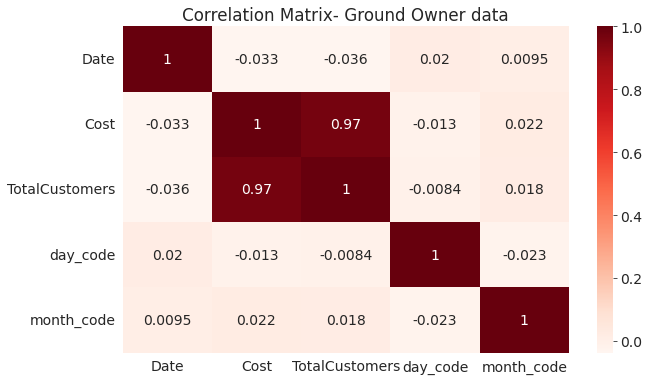

In [18]:
correlation_matrix_ground(gO1_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


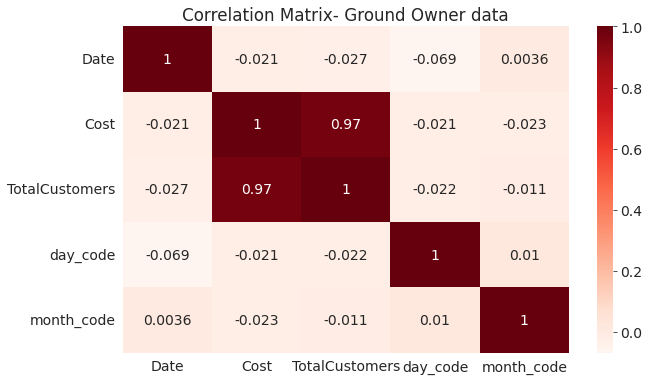

In [19]:
correlation_matrix_ground(gO2_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


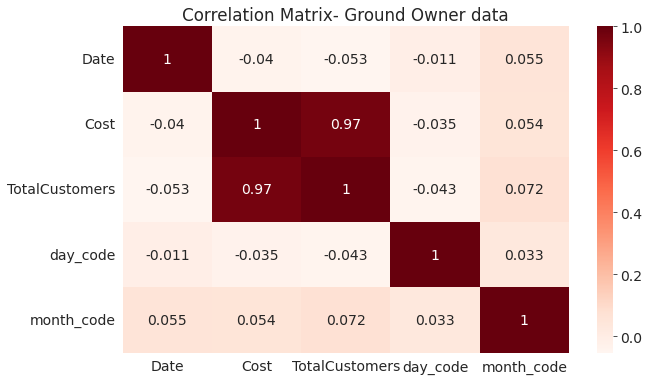

In [20]:
correlation_matrix_ground(gO3_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


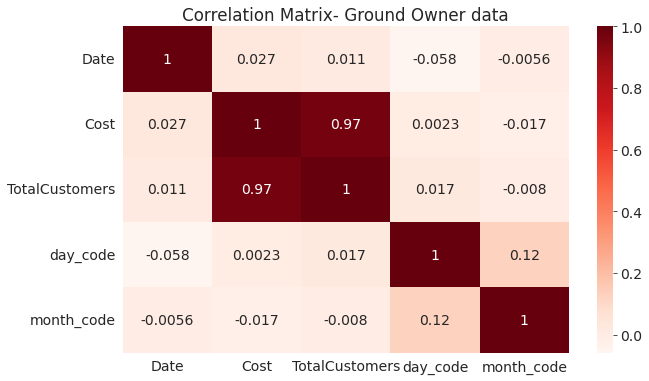

In [21]:
correlation_matrix_ground(gO4_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


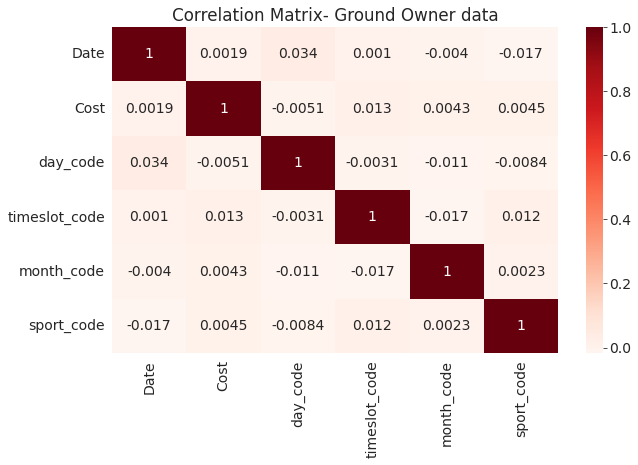

In [22]:
correlation_matrix_cust(gO1_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


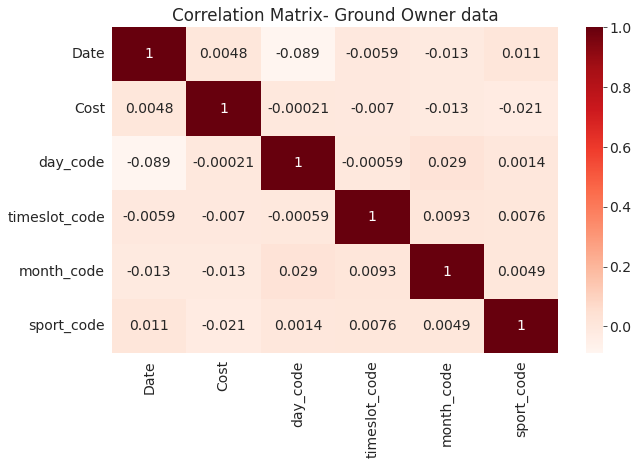

In [23]:
correlation_matrix_cust(gO2_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


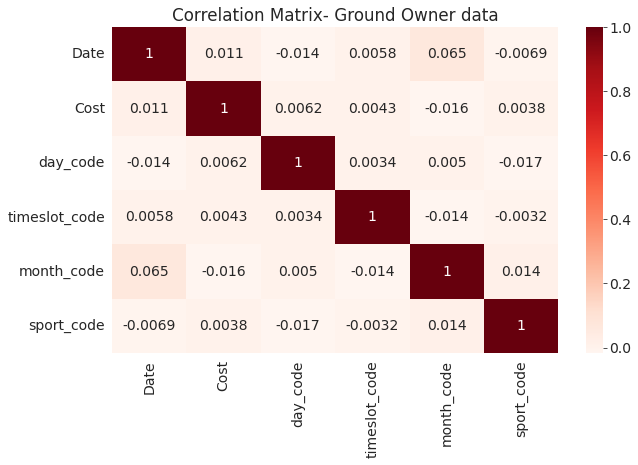

In [24]:
correlation_matrix_cust(gO3_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


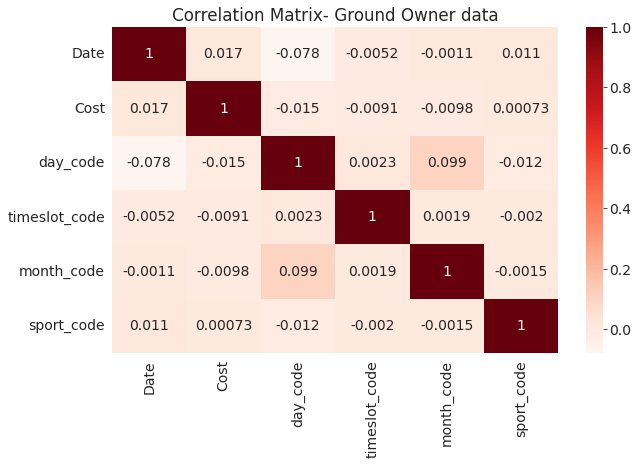

In [25]:
correlation_matrix_cust(gO4_Cust_df)

# Preprocessing for fitting into Models

In [26]:
print(gO1_Cost_df.shape)
gO1_Cost_df.head()

(787, 9)


,Date,Year,Day,Month,GroundName,Cost,TotalCustomers,day_code,month_code
2,3,2010,Friday,January,Ground1,2550,10,4,0
3,4,2010,Friday,April,Ground1,4550,18,4,3
5,6,2010,Friday,November,Ground1,1650,8,4,10
9,10,2010,Wednesday,September,Ground1,4450,21,2,8
11,12,2010,Friday,October,Ground1,6650,25,4,9


In [27]:
gO1_Cost_df.nunique()

Date              787
Year               12
Day                 7
Month              12
GroundName          1
Cost              149
TotalCustomers     26
day_code            7
month_code         12
dtype: int64

In [28]:
gO1_Cost_df = gO1_Cost_df.drop(['Date','Year','GroundName','day_code','month_code'],axis=1)
# gO1_Cost_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
gO1_Cost_df.head()

,Day,Month,Cost,TotalCustomers
2,Friday,January,2550,10
3,Friday,April,4550,18
5,Friday,November,1650,8
9,Wednesday,September,4450,21
11,Friday,October,6650,25


In [29]:
gO1_Cost_df.shape

(787, 4)

In [30]:
print(gO1_Cust_df.shape)
gO1_Cust_df.head()

(12854, 12)


,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost,day_code,timeslot_code,month_code,sport_code
35,3,2010,Friday,January,timeslot4,sport1,Ground1,450,4,3,0,0
36,3,2010,Friday,January,timeslot4,sport4,Ground1,250,4,3,0,3
37,3,2010,Friday,January,timeslot3,sport3,Ground1,150,4,2,0,2
38,3,2010,Friday,January,timeslot5,sport6,Ground1,250,4,4,0,5
39,3,2010,Friday,January,timeslot5,sport3,Ground1,200,4,4,0,2


In [31]:
gO1_Cust_df.nunique()

Date             787
Year              12
Day                7
Month             12
TimeSlot           7
Sport              6
GroundName         1
Cost               9
day_code           7
timeslot_code      7
month_code        12
sport_code         6
dtype: int64

In [32]:
gO1_Cust_df = gO1_Cust_df.drop(['Date','Year','GroundName','day_code','month_code','timeslot_code','sport_code'],axis=1)
# gO1_Cust_df = pd.get_dummies(gO1_Cust_df,drop_first=True)
gO1_Cust_df.head()

,Day,Month,TimeSlot,Sport,Cost
35,Friday,January,timeslot4,sport1,450
36,Friday,January,timeslot4,sport4,250
37,Friday,January,timeslot3,sport3,150
38,Friday,January,timeslot5,sport6,250
39,Friday,January,timeslot5,sport3,200


In [33]:
gO1_Cust_df.columns

Index(['Day', 'Month', 'TimeSlot', 'Sport', 'Cost'], dtype='object')

# Linear, Lasso , Ridge Models

In [34]:
linear_1 = gO1_Cost_df[['TotalCustomers','Cost']]
print(linear_1.shape)
linear_1.head()

(787, 2)


,TotalCustomers,Cost
2,10,2550
3,18,4550
5,8,1650
9,21,4450
11,25,6650


Text(0, 0.5, 'Revenue of that day')

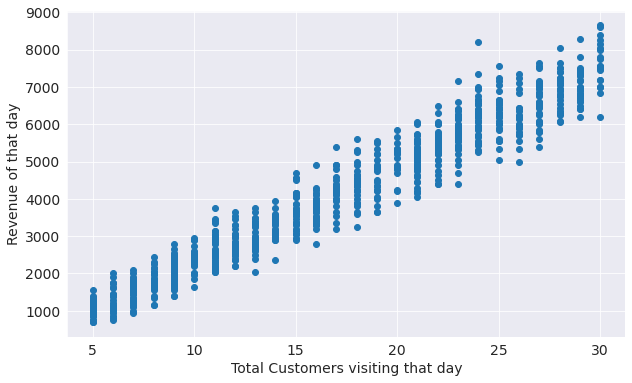

In [35]:
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [36]:
linear_1_X = linear_1.iloc[:,0:1]
linear_1_y = linear_1.iloc[:,-1]

In [37]:
linear_1_X.head()

,TotalCustomers
2,10
3,18
5,8
9,21
11,25


In [38]:
linear_1_y.head()

2     2550
3     4550
5     1650
9     4450
11    6650
Name: Cost, dtype: int64

In [39]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(linear_1_X,linear_1_y,test_size = 0.2,random_state=2)

In [40]:
from sklearn.linear_model import LinearRegression
lr_1 = LinearRegression()


In [41]:
lr_1.fit(X_train,y_train)

LinearRegression()

In [42]:
X_test.head()

,TotalCustomers
71,29
1963,9
2753,17
2022,12
383,26


In [43]:
y_test.head()

71      6400
1963    1950
2753    4900
2022    3000
383     5700
Name: Cost, dtype: int64

In [44]:
X_test.iloc[1]

TotalCustomers    9
Name: 1963, dtype: int64

In [45]:
lr_1.predict(X_test.iloc[1].values.reshape(1,1))

array([2073.63967852])

In [46]:
#regression metrics 


Text(0, 0.5, 'Revenue of that day')

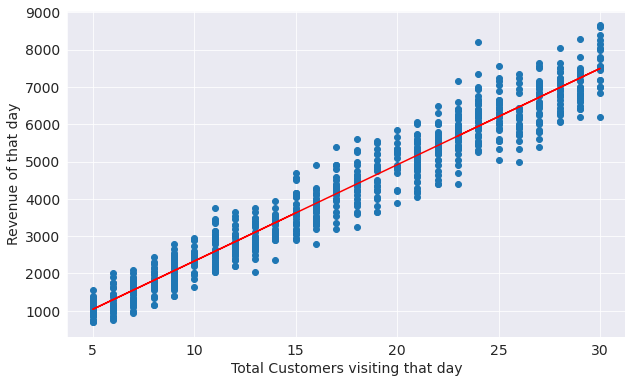

In [47]:
# line of best fit : 
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.plot(X_train.to_numpy(),lr_1.predict(X_train),color='red')
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [48]:
w_lr_1 = lr_1.coef_
b_lr_1 = lr_1.intercept_
print('weight:'+str(w_lr_1))
print('bias :'+str(b_lr_1))
# revenue = w * totalCust + b

weight:[258.34427575]
bias :-251.45880327505438


In [49]:
gO1_Cost_df

,Day,Month,Cost,TotalCustomers
2,Friday,January,2550,10
3,Friday,April,4550,18
5,Friday,November,1650,8
9,Wednesday,September,4450,21
11,Friday,October,6650,25
...,...,...,...,...
2971,Wednesday,April,3900,18
2973,Wednesday,May,4450,21
2975,Wednesday,September,1050,5
2991,Friday,August,3900,18


In [50]:
linear_2 = pd.get_dummies(gO1_Cost_df,drop_first=True)
print(linear_2.shape)
print(linear_2.columns)
linear_2.head()

(787, 19)
Index(['Cost', 'TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')


,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
2,2550,10,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
3,4550,18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,1650,8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
9,4450,21,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1
11,6650,25,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [51]:
# 18 dimensional hyperplane
# cost = b0 + b1.totCust + b2.day_mon + ... +b17.month_sept 


In [52]:
# hyperplane for 3d data 
from sklearn.datasets import make_regression
import plotly.express as px
import plotly.graph_objects as go

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [53]:
try_X,try_y = make_regression(n_samples = 1000, n_features = 2, n_informative=2,n_targets= 1,noise=50)


In [54]:
try_df = pd.DataFrame({'feature1':try_X[:,0],'feature2':try_X[:,1],'target':try_y})

In [55]:
try_df.head()

,feature1,feature2,target
0,1.561761,0.997788,57.167765
1,-0.519213,0.143369,11.286978
2,0.767740,0.338734,0.350365
3,0.828442,1.659630,144.245774
4,0.261191,0.739265,5.692424


In [56]:
try_df.shape

(1000, 3)

In [57]:
try_fig = px.scatter_3d(try_df,x='feature1',y='feature2',z='target')

In [58]:
try_fig.show()

In [59]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(try_X,try_y,test_size=0.2,random_state=3)


In [60]:
from sklearn.linear_model import LinearRegression

In [61]:
lr = LinearRegression()
lr.fit(X_train,y_train)

LinearRegression()

In [62]:
y_pred = lr.predict(X_test)

In [64]:
print("Mean Absolute error",mean_absolute_error(y_test,y_pred))
print("Mean Square error",mean_squared_error(y_test,y_pred))
print("R2 score",r2_score(y_test,y_pred))

Mean Absolute error 42.50169061024904
Mean Square error 2847.9415980927147
R2 score 0.6808887461221551


In [67]:
x = np.linspace(-5, 5, 10)
y = np.linspace(-5, 5, 10)
xGrid, yGrid = np.meshgrid(y, x)

z_final = lr.predict(X_test).reshape(10,10)

z = z_final

final = np.vstack((xGrid.ravel().reshape(1,100),yGrid.ravel().reshape(1,100))).T

ValueError: cannot reshape array of size 200 into shape (10,10)

In [ ]:
fig = px.scatter_3d(df, x='feature1', y='feature2', z='target')

fig.add_trace(go.Surface(x = x, y = y, z =z ))

fig.show()

# Decision Tree

# Random Forest 

# XG Boosting